# Food Deserts in Northern CA
---

## ...

In [1]:
# Dependencies and Setup
import hvplot.pandas
import requests
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import scipy.stats as st

In [2]:
# Load the CSV file created in Part 1 into a Pandas DataFrame
food_deserts_usa = pd.read_csv("Resources/StateAndCountyData.csv")

# Display sample data
food_deserts_usa.head()

,FIPS,State,County,Variable_Code,Value
0,1001,AL,Autauga,LACCESS_POP10,18428.439690
1,1001,AL,Autauga,LACCESS_POP15,17496.693040
2,1001,AL,Autauga,PCH_LACCESS_POP_10_15,-5.056026
3,1001,AL,Autauga,PCT_LACCESS_POP10,33.769657
4,1001,AL,Autauga,PCT_LACCESS_POP15,32.062255


---

### Create Clean DataFrames for CA, The Bay Area, Greater Sacremento, and The Cental Valley.

In [3]:
#create a df that includes only the Counties in CA
food_deserts_ca = food_deserts_usa.loc[food_deserts_usa['State'] == 'CA']


In [4]:
#Rotate the "Variable Codes" into the columns and then match them with the corresponding "Values" 
food_deserts_ca = food_deserts_ca.pivot_table(index=['County', 'FIPS'], columns='Variable_Code', values='Value')
food_deserts_ca.head()

,Variable_Code,AGRITRSM_OPS07,AGRITRSM_OPS12,AGRITRSM_RCT07,AGRITRSM_RCT12,BERRY_ACRES07,BERRY_ACRES12,BERRY_ACRESPTH07,BERRY_ACRESPTH12,BERRY_FARMS07,BERRY_FARMS12,...,WICS16,WICSPTH11,WICSPTH16,WIC_PART_2012,WIC_PART_2013,WIC_PART_2014,WIC_PART_2015,WIC_PART_2016,WIC_PART_2017,WIC_PART_2018
County,FIPS,,,,,,,,,,,,,,,,,,,,,
Alameda,6001,4.0,16.0,29000.0,196000.0,NaN,2.0,NaN,0.001285,1.0,8.0,...,145.0,0.116264,0.087862,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alpine,6003,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Amador,6005,5.0,13.0,NaN,1037000.0,NaN,2.0,NaN,0.053910,2.0,11.0,...,9.0,0.239757,0.240397,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Butte,6007,22.0,38.0,287000.0,392000.0,65.0,84.0,0.298893,0.379738,33.0,34.0,...,23.0,0.131847,0.101532,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Calaveras,6009,6.0,20.0,116000.0,1493000.0,23.0,20.0,0.497104,0.446877,14.0,14.0,...,7.0,0.243578,0.154515,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
#print the California data to a csv
food_deserts_ca.to_csv("Outputs/all_ca_data.csv", index_label="County")

### Step 2: Narrow down the `food_deserts_ca` DataFrame to regions

In [51]:
rest_and_grocery_columns = ['GROC11', "GROC16", "PCH_GROC_11_16", "SUPERC11", "SUPERC16", 
                            "PCH_SUPERC_11_16", "SPECS11", "SPECS16", "PCH_SPECS_11_16", "FFR11",
                             "FFR16", "PCH_FFR_11_16", 'FSR11', 'FSR16', 'PCH_FSR_11_16'] 

df_2 = pd.DataFrame([])

def function1(df_1, df_2):

    df_2 = df_1[rest_and_grocery_columns]

    df_2 = df_2.rename(columns={'GROC11': 'Grocery stores, 2011', 
                                                'GROC16': 'Grocery stores, 2016',
                                                'PCH_GROC_11_16': '% Change in grocery stores, 2011-2016',
                                                'SUPERC11': 'Supercenters, 2011',
                                                'SUPERC16': 'Supercenters, 2016',
                                                'PCH_SUPERC_11_16': '% Change in supercenters, 2011-2016',
                                                'SPECS11': 'Specialized food stores, 2011',
                                                'SPECS16': 'Specialized food stores, 2016',
                                                'PCH_SPECS_11_16': '% Change in specialized food stores, 2011-2016',
                                                'FFR11': 'Fast-food restaurants, 2011',
                                                'FFR16': 'Fast-food restaurants, 2016',
                                                'PCH_FFR_11_16': '% Change in fast-food restaurants, 2011-2016',
                                                'FSR11': 'Full-service restaurants, 2011',
                                                'FSR16': 'Full-service restaurants, 2016',
                                                'PCH_FSR_11_16': '% Change in full-service restaurants, 2011-2016'})
    df_2 = df_2.fillna(0)

    return df_2

In [7]:
rest_and_grocery_data_ca = function1(food_deserts_ca, rest_and_grocery_data_ca)

rest_and_grocery_data_ca.head()

,Variable_Code,"Grocery stores, 2011","Grocery stores, 2016","% Change in grocery stores, 2011-2016","Supercenters, 2011","Supercenters, 2016","% Change in supercenters, 2011-2016","Specialized food stores, 2011","Specialized food stores, 2016","% Change in specialized food stores, 2011-2016","Fast-food restaurants, 2011","Fast-food restaurants, 2016","% Change in fast-food restaurants, 2011-2016","Full-service restaurants, 2011","Full-service restaurants, 2016","% Change in full-service restaurants, 2011-2016"
County,FIPS,,,,,,,,,,,,,,,
Alameda,6001,387.0,372.0,-3.875969,6.0,6.0,0.0,156.0,133.0,-14.743590,1090.0,1293.0,18.623853,1401.0,1560.0,11.349036
Alpine,6003,1.0,0.0,-100.000000,0.0,0.0,0.0,0.0,0.0,0.000000,2.0,0.0,-100.000000,3.0,1.0,-66.666667
Amador,6005,11.0,13.0,18.181818,0.0,0.0,0.0,2.0,5.0,150.000000,12.0,21.0,75.000000,39.0,44.0,12.820513
Butte,6007,46.0,45.0,-2.173913,1.0,1.0,0.0,18.0,13.0,-27.777778,147.0,158.0,7.482993,125.0,132.0,5.600000
Calaveras,6009,13.0,11.0,-15.384615,0.0,0.0,0.0,4.0,3.0,-25.000000,26.0,30.0,15.384615,39.0,41.0,5.128205


In [8]:
bay_area_counties = ['Alameda', 'Contra Costa', 'Marin', 'Napa', 
                     'San Francisco', 'San Mateo', 'Santa Clara', 
                     'Solano', 'Sonoma']
bay_area_desert = food_deserts_ca.loc[bay_area_counties]

In [9]:
ba_rest_and_grocery_data = pd.DataFrame([])
ba_rest_and_grocery_data = function1(bay_area_desert, ba_rest_and_grocery_data)

In [10]:
sacramento_counties = ['Amador', 'Calaveras', 'El Dorado', 'Placer', 
                        'Sacramento', 'Yolo']
    
sacramento_desert = food_deserts_ca.loc[sacramento_counties]

In [11]:
sac_rest_and_grocery_data = pd.DataFrame([])

sac_rest_and_grocery_data = function1(sacramento_desert, sac_rest_and_grocery_data)

In [12]:
central_valley_counties = ['Fresno', 'Kern', 'Kings', 
                            'Madera', 'Mariposa', 'Merced', 'San Joaquin', 
                            'Stanislaus', 'Tulare', 'Tuolumne']

central_valley_desert =  food_deserts_ca.loc[central_valley_counties]

In [13]:
cv_rest_and_grocery_data = pd.DataFrame([])

cv_rest_and_grocery_data = function1(central_valley_desert, cv_rest_and_grocery_data)

In [14]:
regions_desert = pd.concat([central_valley_desert, sacramento_desert, bay_area_desert])

In [15]:
region_rest_and_grocery = pd.DataFrame([])

region_rest_and_grocery = function1(regions_desert, region_rest_and_grocery)

region_rest_and_grocery

,Variable_Code,"Grocery stores, 2011","Grocery stores, 2016","% Change in grocery stores, 2011-2016","Supercenters, 2011","Supercenters, 2016","% Change in supercenters, 2011-2016","Specialized food stores, 2011","Specialized food stores, 2016","% Change in specialized food stores, 2011-2016","Fast-food restaurants, 2011","Fast-food restaurants, 2016","% Change in fast-food restaurants, 2011-2016","Full-service restaurants, 2011","Full-service restaurants, 2016","% Change in full-service restaurants, 2011-2016"
County,FIPS,,,,,,,,,,,,,,,
Fresno,6019,233.0,257.0,10.300429,5.0,10.0,100.000000,77.0,73.0,-5.194805,569.0,634.0,11.423550,490.0,519.0,5.918367
Kern,6029,181.0,187.0,3.314917,4.0,8.0,100.000000,56.0,40.0,-28.571429,528.0,603.0,14.204545,400.0,443.0,10.750000
Kings,6031,32.0,28.0,-12.500000,1.0,2.0,100.000000,4.0,5.0,25.000000,90.0,89.0,-1.111111,46.0,45.0,-2.173913
Madera,6039,35.0,38.0,8.571429,0.0,0.0,0.000000,10.0,10.0,0.000000,75.0,78.0,4.000000,48.0,52.0,8.333333
Mariposa,6043,9.0,5.0,-44.444444,0.0,0.0,0.000000,1.0,0.0,-100.000000,9.0,8.0,-11.111111,12.0,13.0,8.333333
Merced,6047,56.0,68.0,21.428571,2.0,3.0,50.000000,16.0,18.0,12.500000,127.0,143.0,12.598425,75.0,91.0,21.333333
San Joaquin,6077,166.0,160.0,-3.614458,4.0,10.0,150.000000,55.0,52.0,-5.454545,401.0,466.0,16.209476,352.0,391.0,11.079545
Stanislaus,6099,134.0,131.0,-2.238806,3.0,4.0,33.333333,31.0,45.0,45.161290,327.0,366.0,11.926606,255.0,293.0,14.901961
Tulare,6107,107.0,119.0,11.214953,3.0,4.0,33.333333,30.0,34.0,13.333333,215.0,264.0,22.790698,210.0,212.0,0.952381


In [16]:
#print the data for three regions we are focusing on to a csv
regions_desert.to_csv("Outputs/combined_regions_data.csv", index_label="County")

In [17]:
#print the restaurant and grocery store data for three regions we are focusing on to a csv
region_rest_and_grocery.to_csv("Outputs/combined_regions_rest_and_grocery.csv", index_label="County")


In [18]:
def plot_linear_regression(x_values, y_values, y_label, title, corr):

    slope, intercept, rvalue, pvalue, stderr = st.linregress(x_values, y_values)
    regress_values = x_values * slope + intercept
    
    corr_coeff, p_value = st.pearsonr(x_values, y_values)



    line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
    plt.scatter(x_values,y_values, color='steelblue')
    plt.plot(x_values,regress_values,"black")
    plt.annotate(line_eq, corr,fontsize=15,color="black")

    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    
    plt.show()
    print(f"Correlation coefficient: {corr_coeff:.2f}")

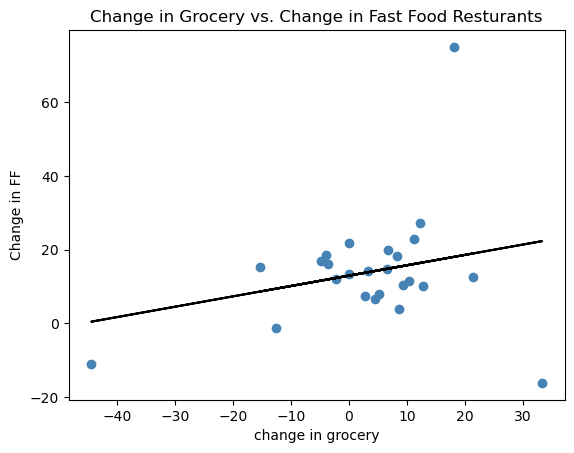

Correlation coefficient: 0.25


In [19]:
x_values = region_rest_and_grocery['% Change in grocery stores, 2011-2016']
y_values = region_rest_and_grocery['% Change in fast-food restaurants, 2011-2016']
title = "Change in Grocery vs. Change in Fast Food Resturants"
y_label = "Change in FF"
x_label = "change in grocery"
corr = (-45,150)

plot_linear_regression(x_values, y_values, y_label, title, corr)

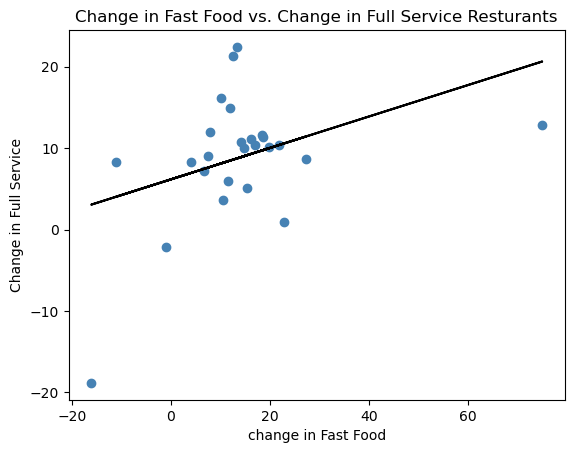

Correlation coefficient: 0.39


In [20]:
x_values = region_rest_and_grocery['% Change in fast-food restaurants, 2011-2016']
y_values = region_rest_and_grocery['% Change in full-service restaurants, 2011-2016']
title = "Change in Fast Food vs. Change in Full Service Resturants"
y_label = "Change in Full Service"
x_label = "change in Fast Food"
corr = (-45,150)

plot_linear_regression(x_values, y_values, y_label, title, corr)

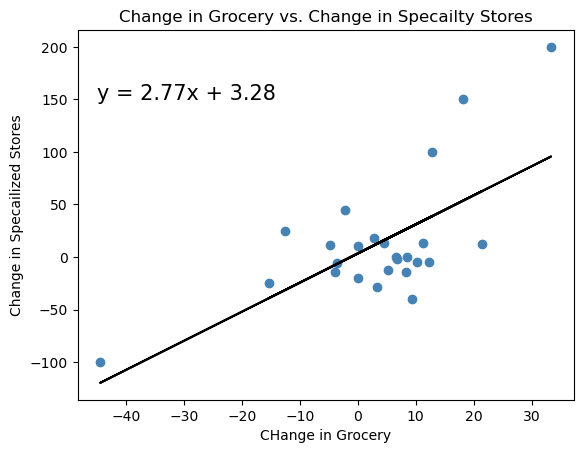

Correlation coefficient: 0.66


In [21]:
x_values = region_rest_and_grocery['% Change in grocery stores, 2011-2016']
y_values = region_rest_and_grocery['% Change in specialized food stores, 2011-2016']
title = "Change in Grocery vs. Change in Specailty Stores"
x_label = "CHange in Grocery"
y_label = "Change in Specailized Stores"
corr = (-45,150)

plot_linear_regression(x_values, y_values, y_label, title, corr)

In [50]:
Access_regions_desert=regions_desert.loc[:,["PCT_LACCESS_POP15","LACCESS_POP10",
                                            "LACCESS_POP15",
                                            "PCH_LACCESS_POP_10_15",
                                            "LACCESS_LOWI10",
                                            "LACCESS_LOWI15",
                                            "PCH_LACCESS_LOWI_10_15"]]

Access_regions_desert=Access_regions_desert.rename(columns={"PCT_LACCESS_POP15":"Population, low access to store (%) 2015", "LACCESS_POP10":"2010 Pop w/Low Store Access",
                                            "LACCESS_POP15":"2015 Pop w/Low Store Access",
                                            "PCH_LACCESS_POP_10_15":"%change 10-15 Pop w/Low Store Access",
                                            "LACCESS_LOWI10":"2010 Low Income Pop w/Low Store Access",
                                            "LACCESS_LOWI15":"2015 Low Income Pop w/Low Store Access",
                                            "PCH_LACCESS_LOWI_10_15":"%change 10-15 Low Income Pop w/Low Store Access"})


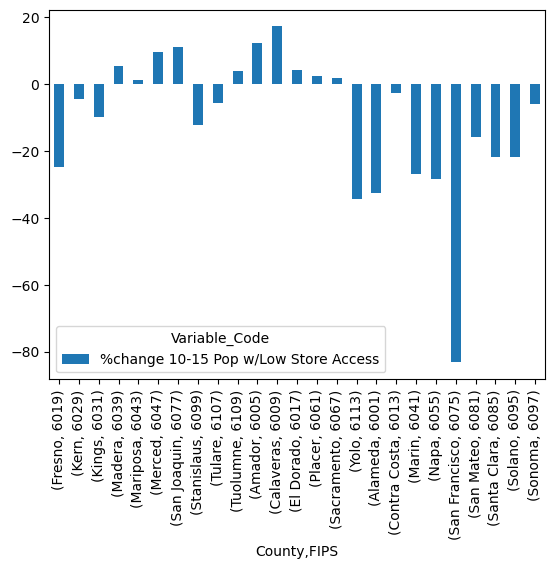

In [23]:
change_in_access_fig = Access_regions_desert[['%change 10-15 Pop w/Low Store Access']]
change_in_access_fig.plot(kind="bar")
plt.show()


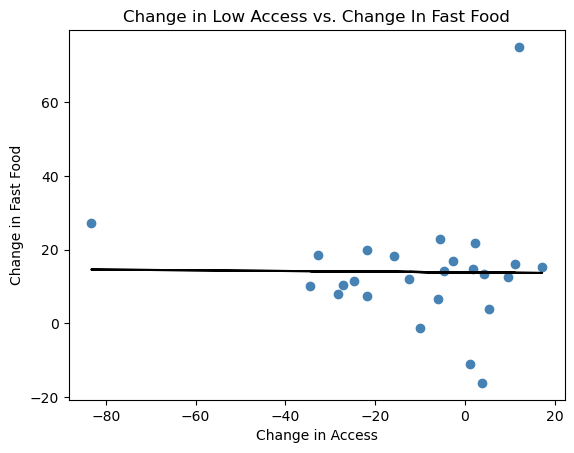

Correlation coefficient: -0.01


In [24]:
x_values = Access_regions_desert['%change 10-15 Pop w/Low Store Access']
y_values = region_rest_and_grocery['% Change in fast-food restaurants, 2011-2016']
title = "Change in Low Access vs. Change In Fast Food"
y_label = "Change in Fast Food"
x_label = "Change in Access"
corr = (-45,150)

plot_linear_regression(x_values, y_values, y_label, title, corr)

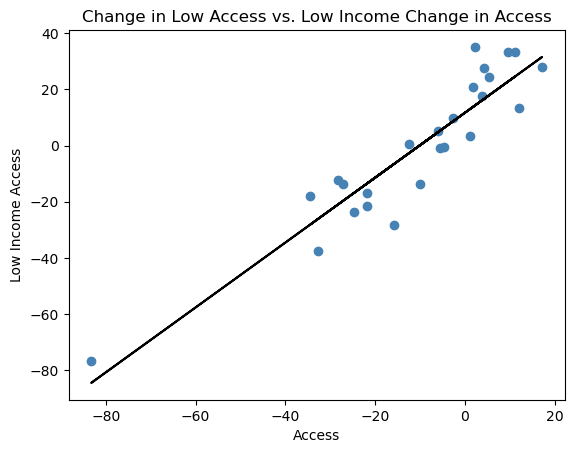

Correlation coefficient: 0.93


In [25]:
x_values = Access_regions_desert['%change 10-15 Pop w/Low Store Access']
y_values = Access_regions_desert['%change 10-15 Low Income Pop w/Low Store Access']
title = "Change in Low Access vs. Low Income Change in Access"
y_label = "Low Income Access"
x_label = "Access"
corr = (-45,150)

plot_linear_regression(x_values, y_values, y_label, title, corr)

In [49]:
access_by_race = regions_desert.loc[:,["PCT_LACCESS_WHITE15","PCT_LACCESS_BLACK15",
                                            "PCT_LACCESS_HISP15",
                                            "PCT_LACCESS_NHASIAN15",
                                            "PCT_LACCESS_NHNA15",
                                            "PCT_LACCESS_NHPI15","PCT_LACCESS_MULTIR15"]]
access_by_race = access_by_race.rename(columns={"PCT_LACCESS_WHITE15": "White, low access to store (%), 2015",
                                            "PCT_LACCESS_BLACK15": "Black or African American, low access to store (%), 2015",
                                            "PCT_LACCESS_HISP15": "Hispanic or Latino, low access to store (%), 2015",
                                            "PCT_LACCESS_NHASIAN15": "Asian, low access to store (%), 2015",
                                            "PCT_LACCESS_NHNA15": "American Indian or Alaska Native, low access to store (%), 2015",
                                            "PCT_LACCESS_NHPI15": "Hawaiian or Pacific Islander, low access to store (%), 2015",
                                            "PCT_LACCESS_MULTIR15": "Multiracial, low access to store (%), 2015"})

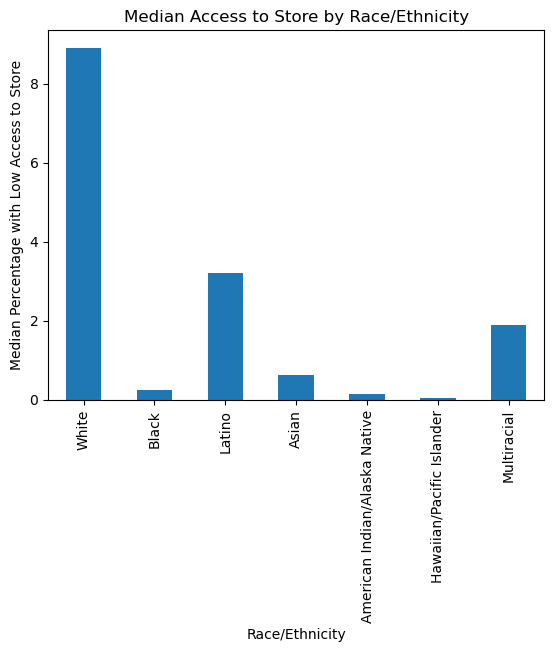

In [27]:
summary_region = access_by_race.median()
ax = summary_region.plot.bar()
ax.set_xticklabels(['White', 'Black', 'Latino', 'Asian', 
                    'American Indian/Alaska Native', 'Hawaiian/Pacific Islander', 
                    'Multiracial'])
ax.set_title("Median Access to Store by Race/Ethnicity")
ax.set_xlabel("Race/Ethnicity")
ax.set_ylabel("Median Percentage with Low Access to Store")
plt.show()

In [28]:
positive_change_counties = Access_regions_desert[Access_regions_desert['%change 10-15 Pop w/Low Store Access'] > 5]

positive_change_counties = positive_change_counties['%change 10-15 Pop w/Low Store Access']
positive_change_counties

County       FIPS
Madera       6039     5.253997
Merced       6047     9.519687
San Joaquin  6077    11.167191
Amador       6005    12.130220
Calaveras    6009    17.169096
Name: %change 10-15 Pop w/Low Store Access, dtype: float64

In [29]:
data_census = pd.read_csv("Resources/co-est2019-alldata.csv", encoding='ISO-8859-1')

data_census = data_census.rename(columns={'CTYNAME': 'County'})
# Display sample data
data_census.head()

,SUMLEV,REGION,DIVISION,STATE,COUNTY,STNAME,County,CENSUS2010POP,ESTIMATESBASE2010,POPESTIMATE2010,...,RDOMESTICMIG2019,RNETMIG2011,RNETMIG2012,RNETMIG2013,RNETMIG2014,RNETMIG2015,RNETMIG2016,RNETMIG2017,RNETMIG2018,RNETMIG2019
0,40,3,6,1,0,Alabama,Alabama,4779736,4780125,4785437,...,1.917501,0.578434,1.186314,1.522549,0.563489,0.626357,0.745172,1.090366,1.773786,2.483744
1,50,3,6,1,1,Alabama,Autauga County,54571,54597,54773,...,4.847310,6.018182,-6.226119,-3.902226,1.970443,-1.712875,4.777171,0.849656,0.540916,4.560062
2,50,3,6,1,3,Alabama,Baldwin County,182265,182265,183112,...,24.017829,16.641870,17.488579,22.751474,20.184334,17.725964,21.279291,22.398256,24.727215,24.380567
3,50,3,6,1,5,Alabama,Barbour County,27457,27455,27327,...,-5.690302,0.292676,-6.897817,-8.132185,-5.140431,-15.724575,-18.238016,-24.998528,-8.754922,-5.165664
4,50,3,6,1,7,Alabama,Bibb County,22915,22915,22870,...,1.385134,-4.998356,-3.787545,-5.797999,1.331144,1.329817,-0.708717,-3.234669,-6.857092,1.831952


In [30]:
census_ca = data_census.loc[data_census['STNAME'] == 'California']
regions_counties = ['Fresno County', 'Kern County', 'Kings County', 
                    'Madera County', 'Mariposa County', 'Merced County', 'San Joaquin County', 
                    'Stanislaus County', 'Tulare County', 'Tuolumne County','Amador County', 
                    'Calaveras County', 'El Dorado County', 'Placer County', 
                    'Sacramento County', 'Yolo County', 'Alameda County', 'Contra Costa County', 'Marin County', 
                    'Napa County', 'San Francisco County', 'San Mateo County', 'Santa Clara County', 
                     'Solano County', 'Sonoma County']

mask = census_ca['County'].isin(regions_counties)
census_regions = census_ca[mask]


pop_change_region = census_regions.groupby('County')['POPESTIMATE2015'].sum() - census_regions.groupby('County')['ESTIMATESBASE2010'].sum()
pop_change_region = pd.DataFrame(pop_change_region)
pop_change_region.columns = ['Pop_Change_2010_2015']
new_order = ['Fresno County', 'Kern County', 'Kings County', 
                    'Madera County', 'Mariposa County', 'Merced County', 'San Joaquin County', 
                    'Stanislaus County', 'Tulare County', 'Tuolumne County','Amador County', 
                    'Calaveras County', 'El Dorado County', 'Placer County', 
                    'Sacramento County', 'Yolo County', 'Alameda County', 'Contra Costa County', 'Marin County', 
                    'Napa County', 'San Francisco County', 'San Mateo County', 'Santa Clara County', 
                      'Solano County', 'Sonoma County']

# new_order = [county.replace(" County", "") for county in new_order]

names = {
    'Fresno County': 'Fresno',
    'Kern County': 'Kern',
    'Kings County': 'Kings',
    'Madera County': 'Madera',
    'Mariposa County': 'Mariposa',
    'Merced County': 'Merced',
    'San Joaquin County': 'San Joaquin',
    'Stanislaus County': 'Stanislaus',
    'Tulare County': 'Tulare',
    'Tuolumne County': 'Tuolumne',
    'Amador County': 'Amador',
    'Calaveras County': 'Calaveras',
    'El Dorado County': 'El Dorado',
    'Placer County': 'Placer',
    'Sacramento County': 'Sacramento',
    'Yolo County': 'Yolo',
    'Alameda County': 'Alameda',
    'Contra Costa County': 'Contra Costa',
    'Marin County': 'Marin',
    'Napa County': 'Napa',
    'San Francisco County': 'San Francisco',
    'San Mateo County': 'San Mateo',
    'Santa Clara County': 'Santa Clara',
    'Solano County': 'Solano',
    'Sonoma County': 'Sonoma'
}

# Use the dictionary to replace county names in the DataFrame
pop_change_region = pop_change_region.reindex(new_order).rename(index=names)

In [48]:
pop_2015_region = census_regions.groupby('County')['POPESTIMATE2015'].sum()
pop_2015_region = pd.DataFrame(pop_2015_region)
pop_2015_region.columns = ['POPESTIMATE2015']
pop_2015_region = pop_2015_region.reindex(new_order).rename(index=names)

pop_change_region = pop_change_region.join(pop_2015_region)

ValueError: columns overlap but no suffix specified: Index(['POPESTIMATE2015'], dtype='object')

In [32]:
merged_data = pd.merge(Access_regions_desert, pop_change_region, left_index=True, right_index=True)

z_scores = np.abs((merged_data['%change 10-15 Pop w/Low Store Access'] - merged_data['%change 10-15 Pop w/Low Store Access'].mean()) / merged_data['%change 10-15 Pop w/Low Store Access'].std())

# find outliers
outliers = merged_data[z_scores > 3]

# print outliers
outliers



,,"Population, low access to store (%) 2015",2010 Pop w/Low Store Access,2015 Pop w/Low Store Access,%change 10-15 Pop w/Low Store Access,2010 Low Income Pop w/Low Store Access,2015 Low Income Pop w/Low Store Access,%change 10-15 Low Income Pop w/Low Store Access,Pop_Change_2010_2015,POPESTIMATE2015
County,FIPS,,,,,,,,,
San Francisco,6075,0.555577,26692.3761,4473.702112,-83.239776,11090.35615,2592.475672,-76.624054,57826,863010


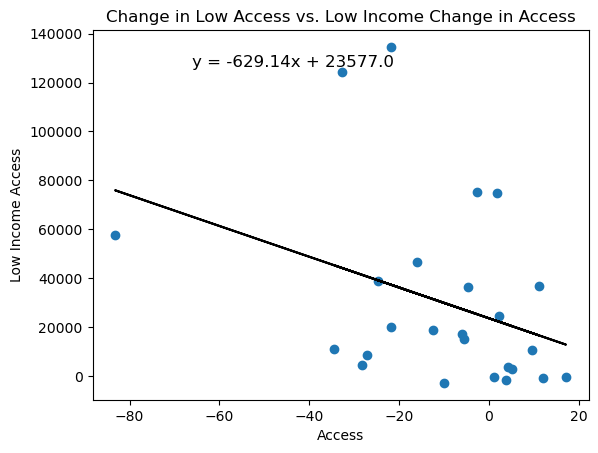

Correlation coefficient: -0.36


In [33]:
# # create the scatter plot

#merged_data_for_scatter = merged_data.drop('San Francisco')

def plot_low_access_v_pop(low_access_data, population_data):

    # Create a scatter plot of the data
    plt.scatter(low_access_data, population_data)
    # Perform linear regression using scipy.stats
    slope, intercept, rvalue, pvalue, stderr = st.linregress(low_access_data, population_data)
    regress_values = low_access_data * slope + intercept

    # Calculate correlation coefficient and p-value using scipy.stats
    corr_coeff, p_value = st.pearsonr(low_access_data, population_data)

    # Create the line equation
    line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))

    # Plot the regression line
    plt.plot(low_access_data, regress_values, color='black')

    # Add the line equation to the plot
    plt.annotate(line_eq, xy=(0.2, 0.9), xycoords='axes fraction', fontsize=12, color='black')

    # Add labels and title
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)

    # Display the plot
    plt.show()

    # Print the correlation coefficient
    print(f"Correlation coefficient: {corr_coeff:.2f}")

plot_low_access_v_pop(merged_data['%change 10-15 Pop w/Low Store Access'], merged_data['Pop_Change_2010_2015'])
x_label = 'Percentage Change in Low Access Population'
y_label = 'Population Change from 2010 to 2015'
title = 'Change in Low Access vs. Population Change'

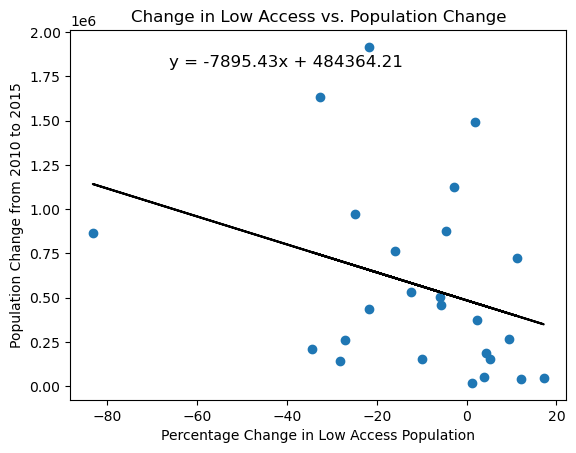

Correlation coefficient: -0.32


In [34]:
plot_low_access_v_pop(merged_data['%change 10-15 Pop w/Low Store Access'], merged_data['POPESTIMATE2015'])
x_label = 'Percentage Change in Low Access Population'
y_label = '2015 County Population'
title = 'Change in Low Access vs. Population'

In [47]:
#make a dataframe with just the county, fips, and "Population, low access to store (%)"

map_df = Access_regions_desert[['Population, low access to store (%) 2015', '2015 Pop w/Low Store Access']]


In [36]:
import geopandas as gpd

ca_counties = gpd.read_file('CA_Counties/CA_Counties_TIGER2016.shp')


In [46]:
regions_counties = ['Fresno', 'Kern', 'Kings', 
                            'Madera', 'Mariposa', 'Merced', 'San Joaquin', 
                            'Stanislaus', 'Tulare', 'Tuolumne','Amador', 'Calaveras', 'El Dorado', 'Placer', 
                        'Sacramento', 'Yolo', 'Alameda', 'Contra Costa', 'Marin', 'Napa', 
                     'San Francisco', 'San Mateo', 'Santa Clara', 
                     'Solano', 'Sonoma']

geo_data = ca_counties[ca_counties['NAME'].isin(regions_counties)]

geo_data = geo_data.rename(columns={'GEOID': 'FIPS','NAME': 'County'})

merged_for_map = map_df.merge(geo_data, on='County')

merged_for_map = merged_for_map[["County", "FIPS", "Population, low access to store (%) 2015", 'geometry']]

In [45]:
# from urllib.request import urlopen
# import json
# import plotly.express as px
# with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#     counties = json.load(response)
    
# fig = px.choropleth(merged_for_map, geojson=counties, locations='FIPS',
#                     hover_name="County", color='Population, low access to store (%) 2015',
#                     color_continuous_scale="Viridis",
#                     range_color=(.5, 29.5), scope="usa")

# fig.update_layout(title_text = '2015 Food Desert % by County in Our Area',margin={"r":0,"t":70,"l":2,"b":0})
# fig.update_geos(fitbounds="locations", visible=True, 
#                 lonaxis=dict(range=[-130, -110]), lataxis=dict(range=[30, 50]))

# #fitbounds="locations"


# fig.show()

In [44]:
from urllib.request import urlopen
import json
import plotly.express as px
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
    
fig = px.choropleth_mapbox(
    merged_for_map, 
    geojson=counties, 
    locations="FIPS",
    hover_name="County",
    color="Population, low access to store (%) 2015",
    color_continuous_scale="Viridis",
    range_color=(0, 30),
    mapbox_style="stamen-terrain",
    center={"lat": 37.5, "lon": -119},
    zoom=5,
    opacity=0.5,
    labels={"Population, low access to store (%) 2015": "Food desert %"},
    title="2015 Food Desert % by County in Our Area",
)

fig.update_layout(margin={"r": 0, "t": 70, "l": 2, "b": 0})

# add Mapbox API token
fig.update_layout(mapbox_accesstoken="pk.eyJ1IjoicHNjdXNoIiwiYSI6ImNsZ3lxMGV2ZTBicTMzZnB1YXc4b2Z1OGUifQ.SKRFpw2ke_Cj6LiIlu_TKw")

fig.show()